# Tracking Data Parse & Explore

# Parsing .jsonl

reading in json file line by line, parse and store it that way.

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [14]:
DATADIR = "/Volumes/Transcend/DataScience/data_bootcamp/data/cap_data"

In [15]:
game_id='/game_2'

## NOTES:
embedded dictionaries are on the following keys:
- homePlayers, awayPlayers, ball
   
- Within each of those there are multiple embedded dictionaries:
   - `frames[idx_frames]['homePlayers'][idx_players].keys()`=dict_keys(['playerId', 'number', 'xyz', 'speed'])
   - `frames[0]['homePlayers'][0]['xyz']` = list of[x,y,z] coords
   - `frames[0]['homePlayers'][0]['speed']` = 1 value, mps - not sure on units
   - `frames[0]['homePlayers'][0]['number']` = 1 value, jersey number
   - `frames[0]['homePlayers'][0]['playerId']` = 1 value, player ID
   - `frames[0]['ball']['xyz']` = list of [x,y,z] coords
   - `frames[0]['ball']['speed']`= 1 value, mps - not sure on units

## Player Tracking

In [16]:
print('x coord: {}'.format(frames[0]['homePlayers'][0]['xyz'][0])) # x coord
print('y coord: {}'.format(frames[0]['homePlayers'][0]['xyz'][1])) # y coord
print('z coord: {}'.format(frames[0]['homePlayers'][0]['xyz'][2])) # z coord
print('speed: {}'.format(frames[0]['homePlayers'][0]['speed'])) # speed
print('player ID: {}'.format(frames[0]['homePlayers'][0]['playerId'])) # player ID
print('player num: {}'.format(frames[0]['homePlayers'][0]['number'])) # player number

NameError: name 'frames' is not defined

## Ball Tracking

In [ ]:
print('ball x coord: {}'.format(frames[0]['ball']['xyz'][0])) # x coord
print('ball y coord: {}'.format(frames[0]['ball']['xyz'][1])) # y coord
print('ball z coord: {}'.format(frames[0]['ball']['xyz'][2])) # z coord

In [ ]:
print('ball speed: {}'.format(frames[0]['ball']['speed']))

# Loop to parse entire list of frames

#### This was necessary to read data in - but saved flattened json to dataframe so I don't have to repeat this if my kernel dies or I want to re-reun the code for some reason

In [ ]:
#This lovely snipped from https://towardsdatascience.com/how-to-flatten-deeply-nested-json-objects-in-non-recursive-elegant-python-55f96533103d
    
from itertools import chain, starmap

def flatten_json_iterative_solution(dictionary):
    """Flatten a nested json file
    https://towardsdatascience.com/how-to-flatten-deeply-nested-json-objects-in-non-recursive-elegant-python-55f96533103d
"""

    def unpack(parent_key, parent_value):
        """Unpack one level of nesting in json file"""
        # Unpack one level only!!!
        
        if isinstance(parent_value, dict):
            for key, value in parent_value.items():
                temp1 = parent_key + '_' + key
                yield temp1, value
        elif isinstance(parent_value, list):
            i = 0 
            for value in parent_value:
                temp2 = parent_key + '_'+str(i) 
                i += 1
                yield temp2, value
        else:
            yield parent_key, parent_value    

            
    # Keep iterating until the termination condition is satisfied
    while True:
        # Keep unpacking the json file until all values are atomic elements (not dictionary or list)
        dictionary = dict(chain.from_iterable(starmap(unpack, dictionary.items())))
        # Terminate condition: not any value in the json file is dictionary or list
        if not any(isinstance(value, dict) for value in dictionary.values()) and \
           not any(isinstance(value, list) for value in dictionary.values()):
            break

    return dictionary

### Flat - er dataframe

In [ ]:
import sys  

In [ ]:
#This takes about 5 minutes
n=len(frames)
frames_df=[]
for frame in range(n):
    frames_df.append(flatten_json_iterative_solution(frames[frame]))
    sys.stdout.write("\r{0}".format((float(frame)/n)*100))
    sys.stdout.flush()

In [ ]:
frames_df[0]

In [ ]:
%%time
#This takes about 30 s
raw_frames=pd.DataFrame(frames_df)

## Save raw_frames Dataframe so I don't have to redo json reading and flattening into dataframe

## Read in raw_frames dataframe - ONLY use this if it is not a new dataset

In [17]:
raw_frames=pd.read_csv(DATADIR+game_id+'/raw_frames.csv')

In [18]:
raw_frames.head()

,period,frameIdx,gameClock,wallClock,homePlayers_0_playerId,homePlayers_0_number,homePlayers_0_xyz_0,homePlayers_0_xyz_1,homePlayers_0_xyz_2,homePlayers_0_speed,...,awayPlayers_10_xyz_1,awayPlayers_10_xyz_2,awayPlayers_10_speed,ball_xyz_0,ball_xyz_1,ball_xyz_2,ball_speed,live,lastTouch,ball_xyz
0,1,0,0.00,1600047504868,463568,17,-0.39,14.72,0.0,0.00,...,13.94,0.0,0.00,0.38,-0.01,0.14,13.18,False,home,NaN
1,1,1,0.04,1600047504908,463568,17,-0.45,14.73,0.0,0.00,...,1.99,0.0,0.00,0.87,-0.04,0.16,13.09,True,home,NaN
2,1,2,0.08,1600047504948,463568,17,-0.52,14.75,0.0,1.91,...,2.07,0.0,1.80,1.46,-0.09,0.15,12.99,True,home,NaN
3,1,3,0.12,1600047504988,463568,17,-0.60,14.76,0.0,2.12,...,13.99,0.0,0.53,2.00,-0.14,0.15,12.89,True,home,NaN
4,1,4,0.16,1600047505028,463568,17,-0.69,14.78,0.0,2.29,...,2.21,0.0,1.73,2.53,-0.19,0.14,12.79,True,home,NaN


In [19]:
raw_frames.shape

(151412, 143)

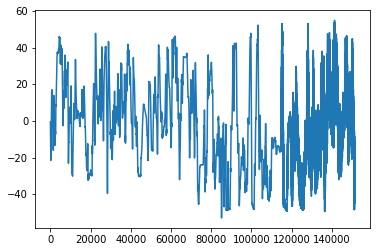

In [20]:
plt.plot(raw_frames['homePlayers_0_xyz_0'])

In [21]:
raw_frames.shape

(151412, 143)

In [22]:
raw_frames['period'].value_counts()

2    78562
1    72850
Name: period, dtype: int64

### NOTE - variables `home_player_columns` & `away_player_columns` are incredibly important and reused a lot throughout the cleaning/re-slicing code

## Create two lists for home and away that is the home and away columns storing tracking data

In [23]:
raw_frames.keys()

Index(['period', 'frameIdx', 'gameClock', 'wallClock',
       'homePlayers_0_playerId', 'homePlayers_0_number', 'homePlayers_0_xyz_0',
       'homePlayers_0_xyz_1', 'homePlayers_0_xyz_2', 'homePlayers_0_speed',
       ...
       'awayPlayers_10_xyz_1', 'awayPlayers_10_xyz_2', 'awayPlayers_10_speed',
       'ball_xyz_0', 'ball_xyz_1', 'ball_xyz_2', 'ball_speed', 'live',
       'lastTouch', 'ball_xyz'],
      dtype='object', length=143)

In [24]:
raw_frames.keys()[4][-9:]

'_playerId'

In [25]:
home_player_columns=[c for c in raw_frames.keys() if c[-7:]=='_number' and c[0:4]=="home"]

In [26]:
away_player_columns = [c for c in raw_frames.keys() if c[-7:]=='_number' and c[0:4]!="home"]

### Plot showing the player ID's are all mixed up in different "position" columns

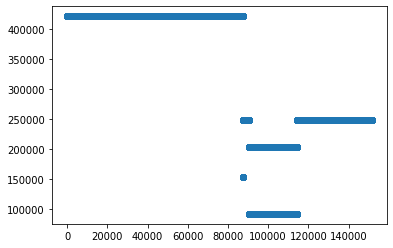

In [27]:
plt.scatter(raw_frames['homePlayers_2_playerId'].index,raw_frames['homePlayers_2_playerId'])

### For some reason 'homePlayers_10_playerId'/'awayPlayers_10_playerId' was throwing some issues
I think it is because of the 'nan' values at the end - might be red cards? I'll have to check that later - 

In [28]:
import copy

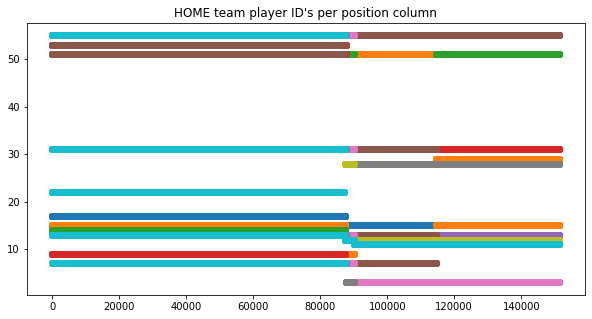

In [29]:
#plot player ID for each of the 11 home_player_x_playerID
plt.figure(figsize=(10,5))
for player_pos in home_player_columns[:10]:
    plt.scatter(raw_frames[player_pos].index,raw_frames[player_pos])
    plt.title('HOME team player ID\'s per position column')    

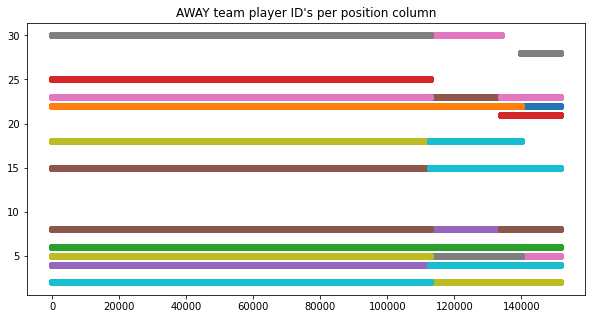

In [30]:
#plot player ID for each of the 11 away_player_x_playerID
plt.figure(figsize=(10,5))
for player_pos in away_player_columns[:10]:
    plt.scatter(raw_frames[player_pos].index,raw_frames[player_pos])
    plt.title('AWAY team player ID\'s per position column')   

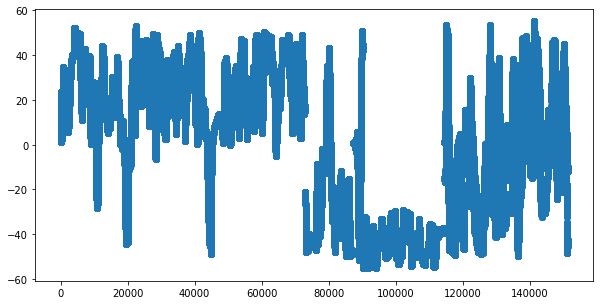

In [31]:
plt.figure(figsize=(10,5))
plt.scatter(raw_frames['homePlayers_1_xyz_0'].index,raw_frames['homePlayers_1_xyz_0'])

## As you can see this is a nightmare - 
the tracking software has the players bouncing around (likely gets confused when they do cross runs etc)


### This is another important loop that generates variable `home_player_list` & `away_player_list`
this is the list of unique player id's in each positional column in `raw_frames` [0-10]

In [32]:
home_player_list=[]
for player_pos in home_player_columns:
    for i in range(len(raw_frames[player_pos].unique())):
        home_player_list.append(raw_frames[player_pos].unique()[i])

In [33]:
len(np.unique(home_player_list))

17

In [34]:
len(home_player_list)

62

In [35]:
away_player_list=[]
for player_pos in away_player_columns:
    for i in range(len(raw_frames[player_pos].unique())):
        away_player_list.append(raw_frames[player_pos].unique()[i])

In [36]:
len(np.unique(away_player_list))

14

In [37]:
len(away_player_list)

37

In [38]:
home_id_columns=[c for c in raw_frames.keys() if c[-9:]=='_playerId' and c[0:4]=="home"]

In [39]:
away_id_columns = [c for c in raw_frames.keys() if c[-9:]=='_playerId' and c[0:4]!="home"]

In [40]:
home_playerId_list=[]
for player_pos in home_id_columns:
    for i in range(len(raw_frames[player_pos].unique())):
        home_playerId_list.append(raw_frames[player_pos].unique()[i])

In [41]:
len(home_playerId_list)

62

In [42]:
away_playerId_list=[]
for player_pos in away_id_columns:
    for i in range(len(raw_frames[player_pos].unique())):
        away_playerId_list.append(raw_frames[player_pos].unique()[i])

In [43]:
len(away_playerId_list)

37

In [44]:
pd.DataFrame([np.unique(away_playerId_list),np.unique(away_player_list)]).T

,0,1
0,54756.0,2.0
1,62535.0,4.0
2,82752.0,5.0
3,89080.0,6.0
4,102626.0,8.0
5,119575.0,15.0
6,182906.0,18.0
7,193194.0,21.0
8,218350.0,22.0
9,225062.0,23.0


In [45]:
player_dict=pd.concat([pd.DataFrame([np.unique(home_playerId_list),
                                     np.unique(home_player_list)]).T,
                       pd.DataFrame([np.unique(away_playerId_list),
                                     np.unique(away_player_list)]).T],
                      axis=0,ignore_index=True).dropna().rename(columns={0:'playerId',1:'jersey_num'})

In [46]:
player_dict

,playerId,jersey_num
0,57252.0,3.0
1,92437.0,7.0
2,110618.0,9.0
3,122836.0,11.0
4,124567.0,12.0
5,153706.0,13.0
6,156787.0,14.0
7,203718.0,15.0
8,213100.0,17.0
9,213563.0,22.0


In [ ]:
player_dict.to_csv(DATADIR+game_id+'/player_id_num.csv',index=False)

### So we have 17 unique home players who played in the game and 21 away players who played in the game

## ** This is an important function I need to properly slice dataframe and rearrange for each players movement

In [47]:
def generate_home_cols(players):
    '''function to create columns with desired player attributes'''
    unq_p=list(set(players))
    cols=[]
    for player in unq_p:
        cols.append('home_'+str(player)+'_x')
        cols.append('home_'+str(player)+'_y')
        cols.append('home_'+str(player)+'_z')
        cols.append('home_'+str(player)+'_speed')
    return cols

def generate_away_cols(players):
    '''function to create columns with desired player attributes'''
    unq_p=list(set(players))
    cols=[]
    for player in unq_p:
        cols.append('away_'+str(player)+'_x')
        cols.append('away_'+str(player)+'_y')
        cols.append('away_'+str(player)+'_z')
        cols.append('away_'+str(player)+'_speed')
    return cols

In [48]:
def isNaN(num):
    '''cute lil guy that determines if an element is nan or not'''
    return num != num

In [49]:
for el in home_player_list:
    if isNaN(el):
        home_player_list.remove(el)
    else:
        pass

In [50]:
for el in away_player_list:
    if isNaN(el):
        away_player_list.remove(el)
    else:
        pass

In [51]:
home_cols=generate_home_cols(home_player_list)

## `unq_p` & `unq_p_a` are both reused a lot

## Getting around the nan columns this way for now

In [52]:
unq_p=list(set(home_player_list))

In [53]:
away_cols=generate_away_cols(away_player_list)

In [54]:
unq_p_a=list(set(away_player_list))

In [55]:
unq_p

[3, 7, 9, 11, 12, 13, 14, 15, 17, 51, 53, 22, 55, 28, 29, 31]

In [56]:
unq_p_a

[2, 4, 5, 6, 8, 15, 18, 21, 22, 23, 25, 28, 30]

## Now I can match unique player ID to column name

### Building a loop so it is automated
It worked for a single player, now build loop to automate for all players

### Recipe for properly looping through raw data, re-slicing it to measure per player in each column (instead of per position)

1. `unq_p`
    - list of unique player id's from player id list that was generated by searching each position column and noting the unique player id's within that column
    - need `player_list` to create this var
2. `raw_frames`
    - dataframe with raw tracking data
3. `home_player_columns`
    - columns in `raw_frames` dataframe
4. generate columns for home/away dataframe you will store tracking info in. You will want x,y,z,speed for each player
5. instantiate dataframe,`tracking_home`, of nans that is the right size to capture every frame
    - rows = `len(raw_frames)`, columns= `home_cols`, index = `raw_frames['frameIdx']`
 

In [57]:
#instantiate home tracking dataframe
#del tracking_home
tracking_home=pd.DataFrame(columns = home_cols,index=raw_frames['frameIdx'])

In [58]:
tracking_home.shape

(151412, 64)

In [59]:
tracking_home.columns

Index(['home_3_x', 'home_3_y', 'home_3_z', 'home_3_speed', 'home_7_x',
       'home_7_y', 'home_7_z', 'home_7_speed', 'home_9_x', 'home_9_y',
       'home_9_z', 'home_9_speed', 'home_11_x', 'home_11_y', 'home_11_z',
       'home_11_speed', 'home_12_x', 'home_12_y', 'home_12_z', 'home_12_speed',
       'home_13_x', 'home_13_y', 'home_13_z', 'home_13_speed', 'home_14_x',
       'home_14_y', 'home_14_z', 'home_14_speed', 'home_15_x', 'home_15_y',
       'home_15_z', 'home_15_speed', 'home_17_x', 'home_17_y', 'home_17_z',
       'home_17_speed', 'home_51_x', 'home_51_y', 'home_51_z', 'home_51_speed',
       'home_53_x', 'home_53_y', 'home_53_z', 'home_53_speed', 'home_22_x',
       'home_22_y', 'home_22_z', 'home_22_speed', 'home_55_x', 'home_55_y',
       'home_55_z', 'home_55_speed', 'home_28_x', 'home_28_y', 'home_28_z',
       'home_28_speed', 'home_29_x', 'home_29_y', 'home_29_z', 'home_29_speed',
       'home_31_x', 'home_31_y', 'home_31_z', 'home_31_speed'],
      dtype='object')

In [60]:
for i,player in enumerate(unq_p):
    temp_player=[] #instantiating empty list to hold dataframes we want to concat with player tracking info
    print('player ' + str(player)+' loop')
    for home_position in home_player_columns:
        x=np.where(raw_frames[home_position]==player)[0]
        if x.size==0:
            pass
        else:
            print(home_position,end=' ')
            print(player,end=' ')
            temp_player.append(pd.DataFrame(raw_frames[['homePlayers_'+home_position.split('_')[1]+'_xyz_0','homePlayers_'+home_position.split('_')[1]+'_xyz_1',
                          'homePlayers_'+home_position.split('_')[1]+'_xyz_2','homePlayers_'+home_position.split('_')[1]+'_speed']].iloc[list(x)].\
                  rename(columns={'homePlayers_'+home_position.split('_')[1]+'_xyz_0':'home_'+str(player)+'_x',
                                  'homePlayers_'+home_position.split('_')[1]+'_xyz_1':'home_'+str(player)+'_y',
                                  'homePlayers_'+home_position.split('_')[1]+'_xyz_2':'home_'+str(player)+'_z',
                                  'homePlayers_'+home_position.split('_')[1]+'_speed':'home_'+str(player)+'_speed'})))
    
    #This has to happen here in order to capture all player movement activity in the various position columns found in the raw "raw_frames dataframe"
    tracking_home[['home_'+str(player)+'_x','home_'+str(player)+'_y','home_'+str(player)+'_z','home_'+str(player)+'_speed']]=pd.concat(temp_player)
    print('')
    print('===============================')


player 3 loop
homePlayers_6_number 3 homePlayers_7_number 3 
player 7 loop
homePlayers_2_number 7 homePlayers_3_number 7 homePlayers_4_number 7 homePlayers_5_number 7 homePlayers_6_number 7 homePlayers_7_number 7 homePlayers_8_number 7 homePlayers_9_number 7 homePlayers_10_number 7 
player 9 loop
homePlayers_1_number 9 homePlayers_3_number 9 
player 11 loop
homePlayers_9_number 11 homePlayers_10_number 11 
player 12 loop
homePlayers_8_number 12 homePlayers_9_number 12 
player 13 loop
homePlayers_3_number 13 homePlayers_4_number 13 homePlayers_5_number 13 homePlayers_6_number 13 homePlayers_7_number 13 homePlayers_8_number 13 homePlayers_9_number 13 homePlayers_10_number 13 
player 14 loop
homePlayers_2_number 14 
player 15 loop
homePlayers_0_number 15 homePlayers_1_number 15 
player 17 loop
homePlayers_0_number 17 
player 51 loop
homePlayers_1_number 51 homePlayers_2_number 51 homePlayers_3_number 51 homePlayers_4_number 51 homePlayers_5_number 51 
player 53 loop
homePlayers_2_number 5

In [61]:
tracking_home

,home_3_x,home_3_y,home_3_z,home_3_speed,home_7_x,home_7_y,home_7_z,home_7_speed,home_9_x,home_9_y,...,home_28_z,home_28_speed,home_29_x,home_29_y,home_29_z,home_29_speed,home_31_x,home_31_y,home_31_z,home_31_speed
frameIdx,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,0.99,-9.30,0.0,0.00,-0.42,23.78,...,NaN,NaN,NaN,NaN,NaN,NaN,-0.18,-0.11,0.0,0.00
1,NaN,NaN,NaN,NaN,0.99,-9.29,0.0,0.00,-0.48,23.79,...,NaN,NaN,NaN,NaN,NaN,NaN,-0.21,-0.10,0.0,0.00
2,NaN,NaN,NaN,NaN,0.99,-9.27,0.0,0.33,-0.56,23.79,...,NaN,NaN,NaN,NaN,NaN,NaN,-0.23,-0.09,0.0,0.70
3,NaN,NaN,NaN,NaN,1.00,-9.26,0.0,0.36,-0.64,23.80,...,NaN,NaN,NaN,NaN,NaN,NaN,-0.26,-0.08,0.0,0.71
4,NaN,NaN,NaN,NaN,1.00,-9.25,0.0,0.34,-0.74,23.80,...,NaN,NaN,NaN,NaN,NaN,NaN,-0.29,-0.08,0.0,0.80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151407,-43.96,24.57,0.0,0.79,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.00,-11.36,8.93,0.0,0.74,-47.54,30.58,0.0,0.53
151408,-43.94,24.59,0.0,0.73,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.08,-11.35,8.90,0.0,0.86,-47.55,30.58,0.0,0.32
151409,-43.91,24.60,0.0,0.72,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.09,-11.34,8.86,0.0,0.90,-47.56,30.58,0.0,0.24


## Do the same loop for the away players

In [62]:
#instantiate home tracking dataframe
#del tracking_home
tracking_away=pd.DataFrame(columns = away_cols,index=raw_frames['frameIdx'])

In [63]:
tracking_away

,away_2_x,away_2_y,away_2_z,away_2_speed,away_4_x,away_4_y,away_4_z,away_4_speed,away_5_x,away_5_y,...,away_25_z,away_25_speed,away_28_x,away_28_y,away_28_z,away_28_speed,away_30_x,away_30_y,away_30_z,away_30_speed
frameIdx,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151407,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
151408,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
151409,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [64]:
for i,player in enumerate(unq_p_a):
    temp_player=[] #instantiating empty list to hold dataframes we want to concat with player tracking info
    print('player ' + str(player)+' loop')
    for position in away_player_columns:
        x=np.where(raw_frames[position]==player)[0]
        if x.size==0:
            pass
        else:
            print(position, end=' ')
            print(player,end=' ')
            temp_player.append(pd.DataFrame(raw_frames[['awayPlayers_'+position.split('_')[1]+'_xyz_0','awayPlayers_'+position.split('_')[1]+'_xyz_1',
                          'awayPlayers_'+position.split('_')[1]+'_xyz_2','awayPlayers_'+position.split('_')[1]+'_speed']].iloc[list(x)].\
                  rename(columns={'awayPlayers_'+position.split('_')[1]+'_xyz_0':'away_'+str(player)+'_x',
                                  'awayPlayers_'+position.split('_')[1]+'_xyz_1':'away_'+str(player)+'_y',
                                  'awayPlayers_'+position.split('_')[1]+'_xyz_2':'away_'+str(player)+'_z',
                                  'awayPlayers_'+position.split('_')[1]+'_speed':'away_'+str(player)+'_speed'})))
    
    #This has to happen here in order to capture all player movement activity in the various position columns found in the raw "raw_frames dataframe"
    tracking_away[['away_'+str(player)+'_x','away_'+str(player)+'_y','away_'+str(player)+'_z','away_'+str(player)+'_speed']]=pd.concat(temp_player)
    print('')
    print('===============================')


player 2 loop
awayPlayers_8_number 2 awayPlayers_9_number 2 
player 4 loop
awayPlayers_2_number 4 awayPlayers_3_number 4 awayPlayers_4_number 4 awayPlayers_9_number 4 awayPlayers_10_number 4 
player 5 loop
awayPlayers_1_number 5 awayPlayers_6_number 5 awayPlayers_7_number 5 awayPlayers_8_number 5 
player 6 loop
awayPlayers_1_number 6 awayPlayers_2_number 6 
player 8 loop
awayPlayers_3_number 8 awayPlayers_4_number 8 awayPlayers_5_number 8 
player 15 loop
awayPlayers_4_number 15 awayPlayers_5_number 15 awayPlayers_9_number 15 awayPlayers_10_number 15 
player 18 loop
awayPlayers_0_number 18 awayPlayers_7_number 18 awayPlayers_8_number 18 awayPlayers_9_number 18 awayPlayers_10_number 18 
player 21 loop
awayPlayers_2_number 21 awayPlayers_3_number 21 
player 22 loop
awayPlayers_0_number 22 awayPlayers_1_number 22 
player 23 loop
awayPlayers_5_number 23 awayPlayers_6_number 23 
player 25 loop
awayPlayers_2_number 25 awayPlayers_3_number 25 
player 28 loop
awayPlayers_7_number 28 
player 30 

# Plot player trajectories to see if sliced and rearranged things the right way

## home players

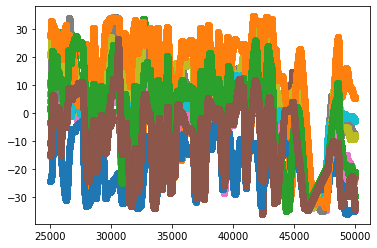

In [65]:
#plot player ID for each of the 11 home_player_x_playerID

for player in home_cols:
    if player[-2:]=="_y": 
        plt.scatter(tracking_home[player].index[25000:50000],tracking_home[player].iloc[25000:50000])
    else: 
        pass

## Loop to plot all 17 players y coord movement throughout the game

Text(0.5, 0, 'Frame #')

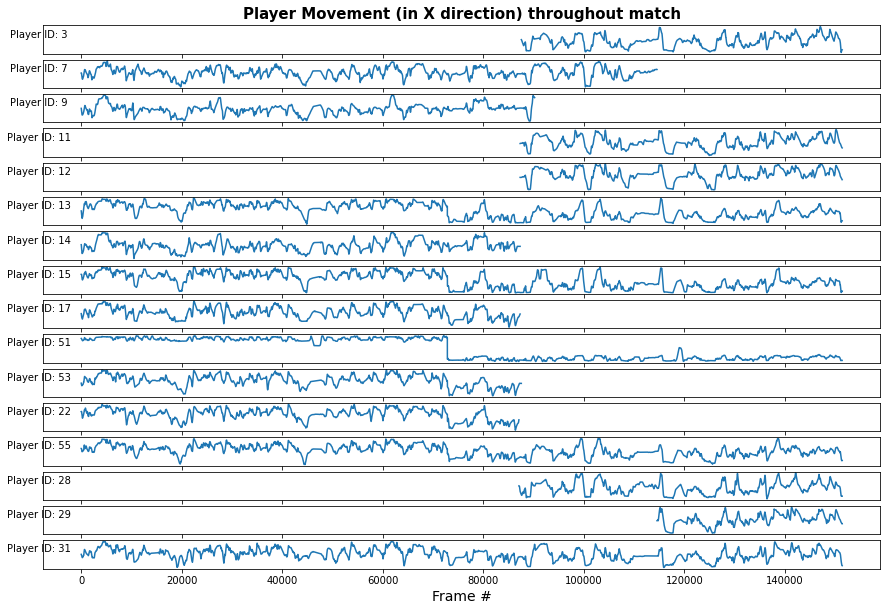

In [66]:
fig, ax = plt.subplots(len(unq_p), 1, sharex='col',figsize=(15,10))

for i,player in enumerate(unq_p):
    ax[i].plot(tracking_home['home_'+str(player)+'_x'].index,
                  tracking_home['home_'+str(player)+'_x']) 
    ax[0].set_title('Player Movement (in X direction) throughout match',fontsize=15, weight='bold')
    ax[i].set_ylabel('Player ID: '+str(player),rotation=0)
    ax[i].set_yticks([])
plt.xlabel('Frame #', fontsize=14)

## Away Players

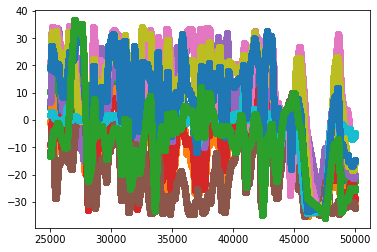

In [67]:
#plot player ID for each of the 11 away_player_x_playerID

for player in away_cols:
    if player[-2:]=="_y": 
        plt.scatter(tracking_away[player].index[25000:50000],tracking_away[player].iloc[25000:50000])

## Loop to plot all 17 players y coord movement throughout the game

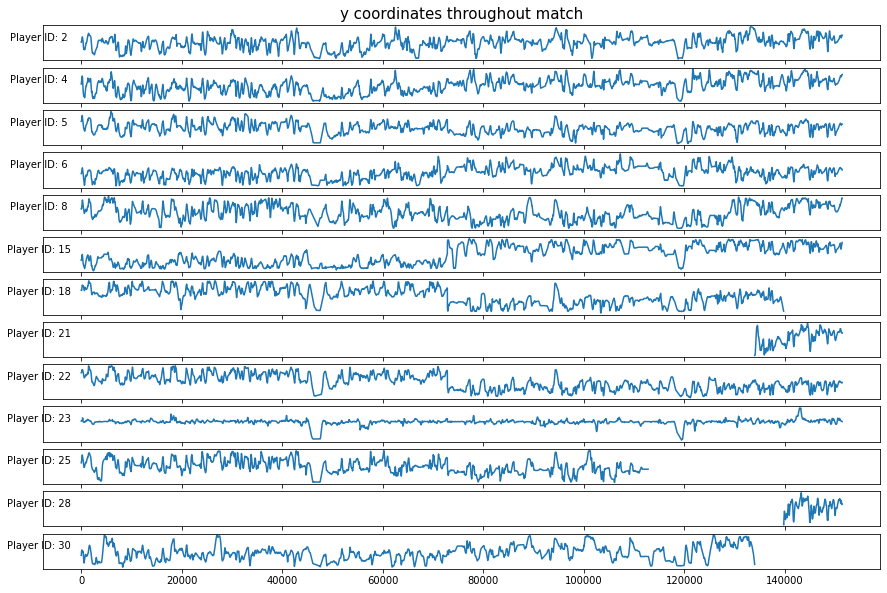

In [68]:
fig, ax = plt.subplots(len(unq_p_a), 1, sharex='col',figsize=(15,10))

#plt.setp(ax, ax.set_ylim([-25, 25]))
#set_ylim([0, 5])

for i,player in enumerate(unq_p_a):
    ax[i].plot(tracking_away['away_'+str(player)+'_y'].index,
                  tracking_away['away_'+str(player)+'_y']) 
    ax[0].set_title('y coordinates throughout match',fontsize=15)
    ax[i].set_ylabel('Player ID: '+str(player),rotation=0)
    ax[i].set_yticks([])

# Attempt some basic functions that were written for lovely clean tutorial dataset

In [69]:
import sys  
sys.path.insert(0, '/Volumes/Transcend/DataScience/data_bootcamp/data/cap_data')

In [70]:
import Metrica_IO_CF as mio
import Metrica_Viz_CF as mviz
import Metrica_Velocities_CF as mvel
import matplotlib.animation as manimation

In [71]:
# Add in Period, Time [s] and ball position columns to home and away dataframes
tracking_home['Time [s]']=tracking_home.index/25
tracking_home['Period']=raw_frames['period']
tracking_home['ball_x']=raw_frames['ball_xyz_0']
tracking_home['ball_y']=raw_frames['ball_xyz_1']
tracking_home['ball_z']=raw_frames['ball_xyz_2']

tracking_away['Time [s]']=tracking_away.index/25
tracking_away['Period']=raw_frames['period']
tracking_away['ball_x']=raw_frames['ball_xyz_0']
tracking_away['ball_y']=raw_frames['ball_xyz_1']
tracking_away['ball_z']=raw_frames['ball_xyz_2']

In [72]:
# reverse direction of play in the second half so that home team is always attacking from right->left
tracking_home,tracking_away = mio.to_single_playing_dir(tracking_home,tracking_away)


In [73]:
# Calculate player velocities
tracking_home = mvel.calc_player_velocities(tracking_home,smoothing=True)
tracking_away = mvel.calc_player_velocities(tracking_away,smoothing=True)

## Adding ball speed now so it doesn't get wiped out by the above function (`calc_player_velocities`)

In [74]:
tracking_home['ball_speed']=raw_frames['ball_speed']
tracking_away['ball_speed']=raw_frames['ball_speed']

# Generating Game clip from tracking data

In [75]:
def clip_array(frame,clip_length):
    if frame-clip_length*.75>0:
        start_frame=frame-clip_length*.75
        end_frame=frame+clip_length*.25
    elif frame-clip_length*.25>0:
        start_frame=frame-clip_length*.25
        end_frame=frame+clip_length*.75
    else:
        start_frame=frame-25
        end_frame=frame+(clip_length-25)
    return int(start_frame),int(end_frame)

In [76]:
start_frame,end_frame=clip_array(102161,300)

In [78]:
### This line is working but blanked it out because gif is already built
# Making a movie of the second home team goal
PLOTDIR = DATADIR+game_id
mviz.save_match_clip(tracking_home.reset_index().iloc[start_frame:end_frame],tracking_away.reset_index().iloc[start_frame:end_frame],PLOTDIR,fname='goal_clip',include_player_velocities=True,balltrack=True)


Generating movie...done


In [79]:
#Display the animation...
import io
import base64
from IPython.display import HTML

filename = '/goal_clip.gif'

video = io.open(DATADIR+game_id+filename, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<img src="data:image/gif;base64,{0}" type="gif" />'''.format(encoded.decode('ascii')))

## Visualize frame with velocities

In [80]:
tracking_away.columns

Index(['away_2_x', 'away_2_y', 'away_2_z', 'away_4_x', 'away_4_y', 'away_4_z',
       'away_5_x', 'away_5_y', 'away_5_z', 'away_6_x', 'away_6_y', 'away_6_z',
       'away_8_x', 'away_8_y', 'away_8_z', 'away_15_x', 'away_15_y',
       'away_15_z', 'away_18_x', 'away_18_y', 'away_18_z', 'away_21_x',
       'away_21_y', 'away_21_z', 'away_22_x', 'away_22_y', 'away_22_z',
       'away_23_x', 'away_23_y', 'away_23_z', 'away_25_x', 'away_25_y',
       'away_25_z', 'away_28_x', 'away_28_y', 'away_28_z', 'away_30_x',
       'away_30_y', 'away_30_z', 'Time [s]', 'Period', 'ball_x', 'ball_y',
       'ball_z', 'away_15_vx', 'away_15_vy', 'away_15_speed', 'away_18_vx',
       'away_18_vy', 'away_18_speed', 'away_2_vx', 'away_2_vy', 'away_2_speed',
       'away_21_vx', 'away_21_vy', 'away_21_speed', 'away_22_vx', 'away_22_vy',
       'away_22_speed', 'away_23_vx', 'away_23_vy', 'away_23_speed',
       'away_25_vx', 'away_25_vy', 'away_25_speed', 'away_28_vx', 'away_28_vy',
       'away_28_speed', '

In [109]:
tracking_home[tracking_home['Period']==2]

,home_3_x,home_3_y,home_3_z,home_7_x,home_7_y,home_7_z,home_9_x,home_9_y,home_9_z,home_11_x,...,home_55_vx,home_55_vy,home_55_speed,home_7_vx,home_7_vy,home_7_speed,home_9_vx,home_9_vy,home_9_speed,ball_speed
frameIdx,,,,,,,,,,,,,,,,,,,,,
72850,NaN,NaN,NaN,3.05,-16.95,0.0,0.25,-10.47,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.60
72851,NaN,NaN,NaN,3.07,-16.95,0.0,0.25,-10.46,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.56
72852,NaN,NaN,NaN,3.10,-16.96,0.0,0.25,-10.45,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.48
72853,NaN,NaN,NaN,3.12,-16.97,0.0,0.24,-10.44,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.39
72854,NaN,NaN,NaN,3.15,-16.98,0.0,0.24,-10.43,0.0,NaN,...,-0.571429,0.035714,0.572544,0.607143,-0.285714,0.671011,-0.178571,0.285714,0.336928,13.29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151407,43.96,-24.57,0.0,NaN,NaN,NaN,NaN,NaN,NaN,20.36,...,-0.357143,0.357143,0.505076,NaN,NaN,NaN,NaN,NaN,NaN,0.00
151408,43.94,-24.59,0.0,NaN,NaN,NaN,NaN,NaN,NaN,20.36,...,-0.285714,0.321429,0.430057,NaN,NaN,NaN,NaN,NaN,NaN,0.00
151409,43.91,-24.60,0.0,NaN,NaN,NaN,NaN,NaN,NaN,20.36,...,-0.258929,0.303571,0.398998,NaN,NaN,NaN,NaN,NaN,NaN,0.00


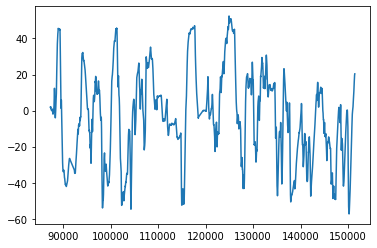

In [111]:
plt.plot(tracking_home['home_11_x'])

(<Figure size 864x576 with 1 Axes>, <AxesSubplot:>)

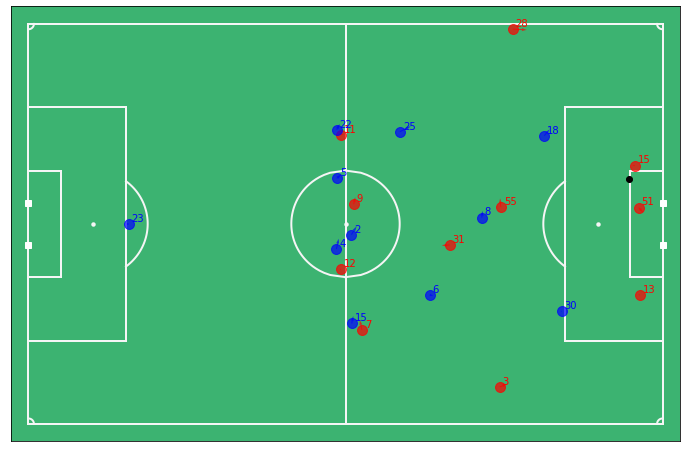

In [113]:
# plot a random frame, plotting the player velocities using quivers
mviz.plot_frame(tracking_home.loc[88000], tracking_away.loc[88000], include_player_velocities=True, annotate=True)


(<Figure size 864x576 with 1 Axes>, <AxesSubplot:>)

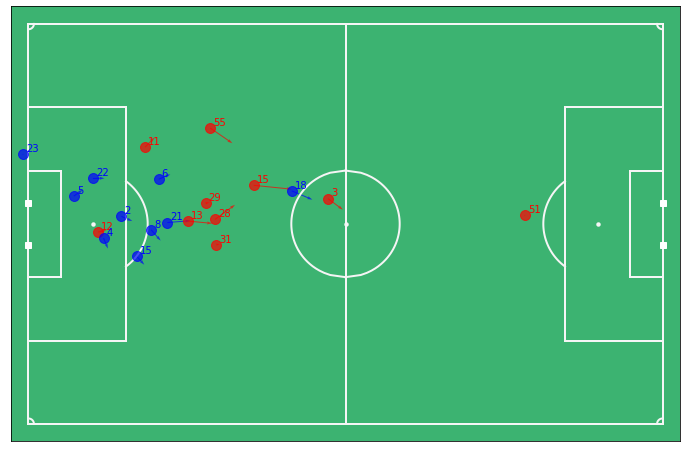

In [82]:
# plot a random frame, plotting the player velocities using quivers
mviz.plot_frame(tracking_home.loc[139000], tracking_away.loc[139000], include_player_velocities=True, annotate=True)

In [83]:
# missing data
total = tracking_home.isnull().sum(axis=1).sort_values(ascending=False)
#percent = (events.isnull().sum()/events.isnull().count()).sort_values(ascending=False)

## Calculate % missing frames

In [84]:
tracking_home

,home_3_x,home_3_y,home_3_z,home_7_x,home_7_y,home_7_z,home_9_x,home_9_y,home_9_z,home_11_x,...,home_55_vx,home_55_vy,home_55_speed,home_7_vx,home_7_vy,home_7_speed,home_9_vx,home_9_vy,home_9_speed,ball_speed
frameIdx,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,0.99,-9.30,0.0,-0.42,23.78,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.18
1,NaN,NaN,NaN,0.99,-9.29,0.0,-0.48,23.79,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.09
2,NaN,NaN,NaN,0.99,-9.27,0.0,-0.56,23.79,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.99
3,NaN,NaN,NaN,1.00,-9.26,0.0,-0.64,23.80,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.89
4,NaN,NaN,NaN,1.00,-9.25,0.0,-0.74,23.80,0.0,NaN,...,-0.142857,4.857226e-17,0.142857,0.071429,0.392857,0.399298,-2.285714,0.071429,2.28683,12.79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151407,43.96,-24.57,0.0,NaN,NaN,NaN,NaN,NaN,NaN,20.36,...,-0.357143,3.571429e-01,0.505076,NaN,NaN,NaN,NaN,NaN,NaN,0.00
151408,43.94,-24.59,0.0,NaN,NaN,NaN,NaN,NaN,NaN,20.36,...,-0.285714,3.214286e-01,0.430057,NaN,NaN,NaN,NaN,NaN,NaN,0.00
151409,43.91,-24.60,0.0,NaN,NaN,NaN,NaN,NaN,NaN,20.36,...,-0.258929,3.035714e-01,0.398998,NaN,NaN,NaN,NaN,NaN,NaN,0.00


In [85]:
home_x_cols=[c for c in tracking_home.keys() if c[-2:]=='_x' and c[:4]=='home']

In [86]:
home_x_cols

['home_3_x',
 'home_7_x',
 'home_9_x',
 'home_11_x',
 'home_12_x',
 'home_13_x',
 'home_14_x',
 'home_15_x',
 'home_17_x',
 'home_51_x',
 'home_53_x',
 'home_22_x',
 'home_55_x',
 'home_28_x',
 'home_29_x',
 'home_31_x']

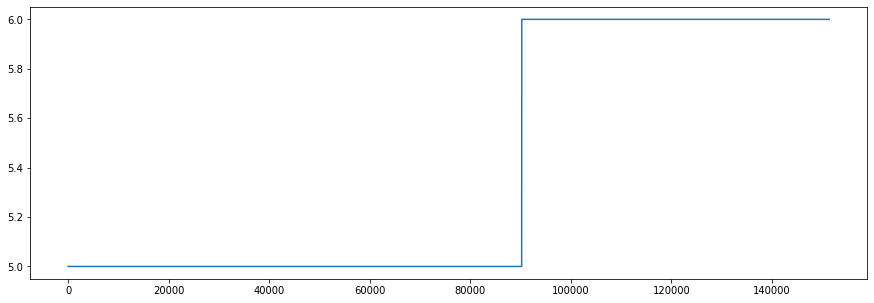

In [87]:
plt.figure(figsize=(15,5))
plt.plot(tracking_home[home_x_cols].isnull().sum(axis=1))


# Save re-oriented home and away tracking data

In [88]:
tracking_home.head()

,home_3_x,home_3_y,home_3_z,home_7_x,home_7_y,home_7_z,home_9_x,home_9_y,home_9_z,home_11_x,...,home_55_vx,home_55_vy,home_55_speed,home_7_vx,home_7_vy,home_7_speed,home_9_vx,home_9_vy,home_9_speed,ball_speed
frameIdx,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,0.99,-9.30,0.0,-0.42,23.78,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.18
1,NaN,NaN,NaN,0.99,-9.29,0.0,-0.48,23.79,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.09
2,NaN,NaN,NaN,0.99,-9.27,0.0,-0.56,23.79,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.99
3,NaN,NaN,NaN,1.00,-9.26,0.0,-0.64,23.80,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.89
4,NaN,NaN,NaN,1.00,-9.25,0.0,-0.74,23.80,0.0,NaN,...,-0.142857,4.857226e-17,0.142857,0.071429,0.392857,0.399298,-2.285714,0.071429,2.28683,12.79


In [89]:
tracking_home.reset_index().to_csv(DATADIR+game_id+'/tracking_home.csv',index=False)

In [90]:
tracking_away.reset_index().to_csv(DATADIR+game_id+'/tracking_away.csv',index=False)

## Upload Tracking

In [9]:
tracking_home=pd.read_csv(DATADIR+game_id+'/tracking_home.csv')

In [10]:
tracking_away=pd.read_csv(DATADIR+game_id+'/tracking_away.csv')

# Create some Player Summaries for HOME TEAM

In [91]:
# Create a Physical summary dataframe for home players
home_players = np.unique( [ c.split('_')[1] for c in tracking_home.columns if c[:4] == 'home' ] )
home_summary = pd.DataFrame(index=unq_p)

In [92]:
home_summary

""
3
7
9
11
12
13
14
15
17
51


In [93]:
# Calculate minutes played for each player
minutes = []
for player in unq_p:
    # search for first and last frames that we have a position observation for each player (when a player is not on the pitch positions are NaN)
    column = 'home_' + str(player) + '_x' # use player x-position coordinate
    player_minutes = ( tracking_home[column].last_valid_index() - tracking_home[column].first_valid_index() + 1 ) / 25 / 60. # convert to minutes
    minutes.append( player_minutes )
home_summary['Minutes Played'] = minutes
home_summary = home_summary.sort_values(['Minutes Played'], ascending=False)

In [94]:
# Calculate total distance covered for each player
distance = []
for player in home_summary.index:
    column = 'home_' + str(player) + '_speed'
    player_distance = tracking_home[column].sum()/25./1000 # this is the sum of the distance travelled from one observation to the next (1/25 = 40ms) in km.
    distance.append( player_distance )
home_summary['Distance [km]'] = distance


In [116]:
import seaborn as sns

In [140]:
home_sum2=home_summary.reset_index().rename(columns={'index':'player'}).sort_values(by='Distance [km]',ascending=False).reset_index()

In [152]:
distance=home_sum2[['player','Distance [km]']]

In [153]:
distance

,player,Distance [km]
0,31,12.273520
1,55,11.787224
2,15,10.276918
3,7,9.405364
4,13,9.127078
5,17,6.678300
6,14,6.538017
7,22,6.325607
8,9,6.083839
9,53,5.837295


Text(0.5, 1.0, 'Distance Covered by each player [km]')

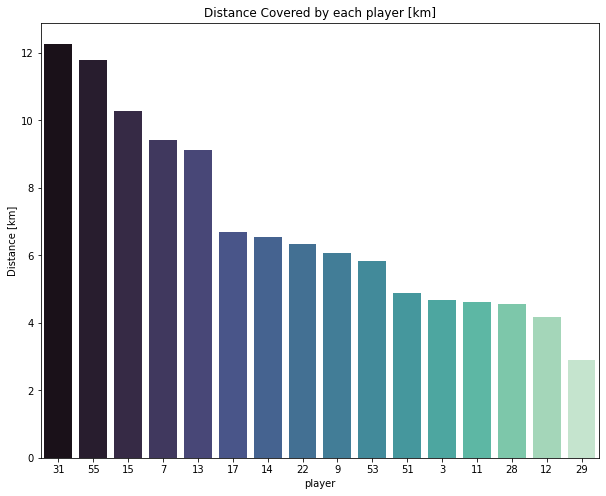

In [166]:
plt.figure(figsize=(10,8))
sns.barplot(x='player', y='Distance [km]',data=distance,palette='mako',order=distance['player'])
plt.title('Distance Covered by each player [km]')

In [149]:
pd_df

,Dim,Count
0,37,99943
1,25,47228
2,36,16933
3,40,14996
4,35,11791
5,34,8030
6,24,6319
7,2,5055
8,39,4758
9,38,4611


<AxesSubplot:xlabel='Dim', ylabel='Count'>

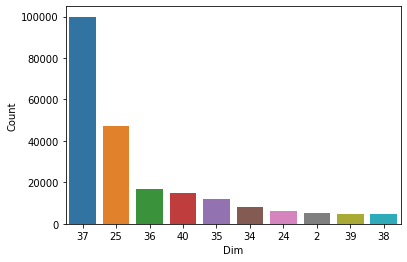

In [148]:
dicti=({'37':99943,'25':47228,'36':16933,'40':14996,'35':11791,'34':8030,'24' : 6319 ,'2'  :5055 ,'39' :4758 ,'38' :4611  })
pd_df = pd.DataFrame(list(dicti.items()))
pd_df.columns =["Dim","Count"]

# Here the dataframe is already sorted if not use the below line
# pd_df = pd_df.sort_values('Count').reset_index()
# or 
# pd_df = pd_df.sort_values('Count',ascending=False).reset_index()

sns.barplot(x='Dim',y='Count',data=pd_df,order = pd_df['Dim'])

In [162]:
minutes=home_summary.reset_index().rename(columns={'index':'player'}).sort_values(by='Minutes Played',ascending=False).reset_index()

Text(0.5, 1.0, 'Minutes Played by each Player')

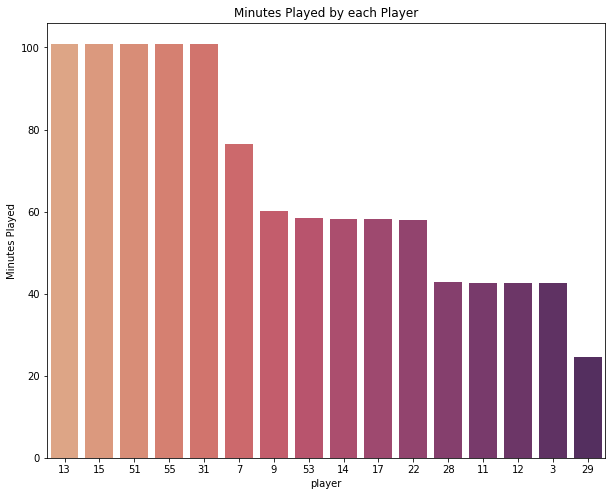

In [164]:
plt.figure(figsize=(10,8))
sns.barplot(x='player', y='Minutes Played',data=minutes,palette='flare',order=minutes['player'])
plt.title('Minutes Played by each Player')

Text(0.5, 1.0, 'Distance covered per player: HOME TEAM')

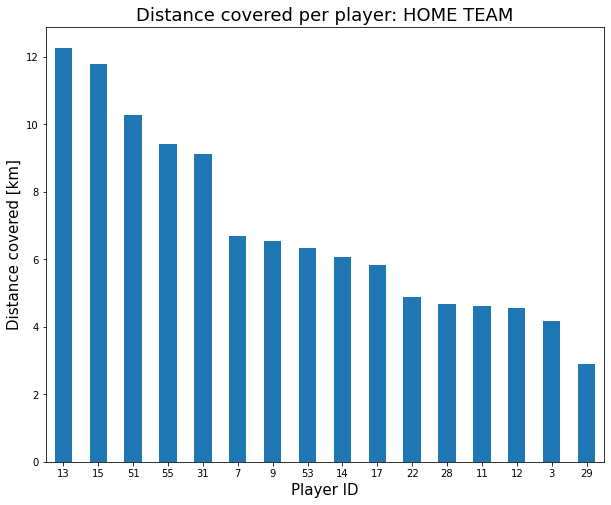

In [114]:
# make a simple bar chart of distance covered for each player
plt.figure(figsize=(10,8))
ax = home_summary['Distance [km]'].sort_values(ascending=False).plot.bar(rot=0)
ax.set_xlabel('Player ID',fontsize=15)
#ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_xticklabels(home_summary.index)
ax.set_ylabel('Distance covered [km]',fontsize=15)
ax.set_title('Distance covered per player: HOME TEAM', fontsize=18)

Text(0.5, 1.0, 'Minutes played per player: HOME TEAM')

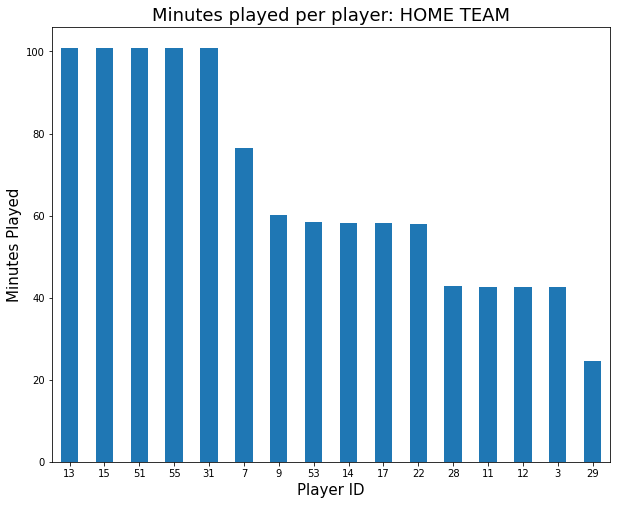

In [96]:
# make a simple bar chart of distance covered for each player
plt.figure(figsize=(10,8))
ax = home_summary['Minutes Played'].plot.bar(rot=0)
ax.set_xlabel('Player ID',fontsize=15)
#ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_xticklabels(home_summary.index)
ax.set_ylabel('Minutes Played',fontsize=15)
ax.set_title('Minutes played per player: HOME TEAM', fontsize=18)

In [97]:
# now calculate distance covered while: walking, joggings, running, sprinting
walking = []
jogging = []
running = []
sprinting = []
for player in home_summary.index:
    column = 'home_' + str(player) + '_speed'
    # walking (less than 2 m/s)
    player_distance = tracking_home.loc[tracking_home[column] < 2, column].sum()/25./1000
    walking.append( player_distance )
    # jogging (between 2 and 4 m/s)
    player_distance = tracking_home.loc[ (tracking_home[column] >= 2) & (tracking_home[column] < 4), column].sum()/25./1000
    jogging.append( player_distance )
    # running (between 4 and 7 m/s)
    player_distance = tracking_home.loc[ (tracking_home[column] >= 4) & (tracking_home[column] < 7), column].sum()/25./1000
    running.append( player_distance )
    # sprinting (greater than 7 m/s)
    player_distance = tracking_home.loc[ tracking_home[column] >= 7, column].sum()/25./1000
    sprinting.append( player_distance )
    
home_summary['Walking [km]'] = walking
home_summary['Jogging [km]'] = jogging
home_summary['Running [km]'] = running
home_summary['Sprinting [km]'] = sprinting

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, '13'),
  Text(1, 0, '15'),
  Text(2, 0, '51'),
  Text(3, 0, '55'),
  Text(4, 0, '31'),
  Text(5, 0, '7'),
  Text(6, 0, '9'),
  Text(7, 0, '53'),
  Text(8, 0, '14'),
  Text(9, 0, '17'),
  Text(10, 0, '22'),
  Text(11, 0, '28'),
  Text(12, 0, '11'),
  Text(13, 0, '12'),
  Text(14, 0, '3'),
  Text(15, 0, '29')])

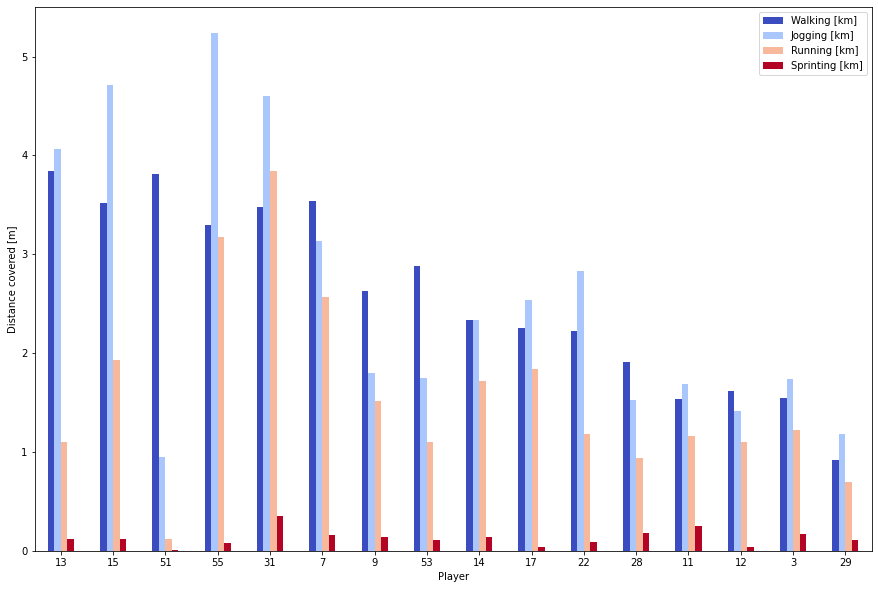

In [98]:
# make a clustered bar chart of distance covered for each player at each speed
ax = home_summary[['Walking [km]','Jogging [km]','Running [km]','Sprinting [km]']].plot.bar(colormap='coolwarm',figsize=(15,10))
ax.set_xlabel('Player')
ax.set_ylabel('Distance covered [m]')
plt.xticks(rotation=0)

In [99]:
# sustained sprints: how many sustained sprints per match did each player complete? Defined as maintaining a speed > 7 m/s for at least 1 second
nsprints = []
sprint_threshold = 7 # minimum speed to be defined as a sprint (m/s)
sprint_window = 1*25 # minimum duration sprint should be sustained (in this case, 1 second = 25 consecutive frames)
for player in home_summary.index:
    column = 'home_' + str(player) + '_speed'
    # trick here is to convolve speed with a window of size 'sprint_window', and find number of occassions that sprint was sustained for at least one window length
    # diff helps us to identify when the window starts
    player_sprints = np.diff( 1*( np.convolve( 1*(tracking_home[column]>=sprint_threshold), np.ones(sprint_window), mode='same' ) >= sprint_window ) )
    nsprints.append( np.sum( player_sprints == 1 ) )
home_summary['# sprints'] = nsprints

In [107]:
# Plot the trajectories for each of player 10's sprints
player = '11'
column = 'home_' + player + '_speed' # spped
column_x = 'home_' + player + '_x' # x position
column_y = 'home_' + player + '_y' # y position
# same trick as before to find start and end indices of windows of size 'sprint_window' in which player speed was above the sprint_threshold
player_sprints = np.diff( 1*( np.convolve( 1*(tracking_home[column]>=sprint_threshold), np.ones(sprint_window), mode='same' ) >= sprint_window ) )
player_sprints_start = np.where( player_sprints == 1 )[0] - int(sprint_window/2) + 1 # adding sprint_window/2 because of the way that the convolution is centred
player_sprints_end = np.where( player_sprints == -1 )[0] + int(sprint_window/2) + 1

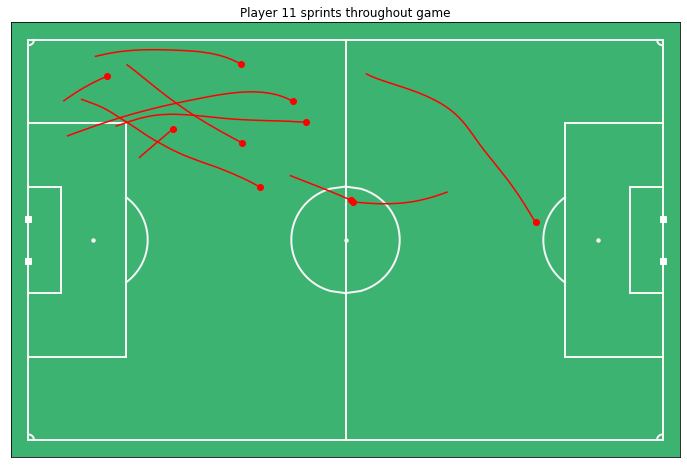

In [108]:
# now plot all the sprints
fig,ax = mviz.plot_pitch()
for s,e in zip(player_sprints_start,player_sprints_end):
    ax.plot(tracking_home[column_x].iloc[s],tracking_home[column_y].iloc[s],'ro')
    ax.plot(tracking_home[column_x].iloc[s:e+1],tracking_home[column_y].iloc[s:e+1],'r')
    ax.set_title('Player '+player+' sprints throughout game')